In [2]:
CUDA_LAUNCH_BLOCKING="1"

In [3]:
import numpy as np
import pandas as pd

import os
import cv2
import matplotlib.pyplot as plt
import seaborn as sns
from mpl_toolkits.axes_grid1 import ImageGrid

import time
import random
from tqdm.notebook import tqdm

plt.style.use("dark_background")

In [4]:
import numpy as np
import pandas as pd
import os
import matplotlib.pyplot as plt
import cv2
import timm
import seaborn as sns
import random

from tqdm.notebook import tqdm
from torch import nn,optim
import torch.nn.functional as F
from torch.utils.data import Dataset,DataLoader
from torchvision import transforms as T
from mpl_toolkits.axes_grid1 import ImageGrid
from torchvision.utils import make_grid
import albumentations as A
from albumentations.pytorch import ToTensorV2
import torch.optim as optim
import torch

from sklearn.metrics import classification_report
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt

import segmentation_models_pytorch as smp
%matplotlib inline
plt.style.use("dark_background")

In [5]:
root_dir = "Y:\Python\Datasets\Brain_Tumor\kaggle_3m"

In [6]:
BASE_LEN = 89
END_LEN = 4
END_MASK_LEN = 9

IMG_SIZE = 512

In [7]:
data = []

for dir_ in os.listdir(root_dir):
    data_dir = os.path.join(root_dir, dir_)
    if os.path.isdir(data_dir):
        for filename in os.listdir(data_dir):
            img_path = os.path.join(data_dir, filename)
            data.append([dir_, img_path])

In [8]:
df = pd.DataFrame(data, columns=["data_dir", "img_path"])

In [9]:
df2 = pd.read_csv(os.path.join(root_dir, "data.csv"))

In [10]:
df2["age_at_initial_pathologic"].mean()

45.8348623853211

In [11]:
df_imgs = df[~df["img_path"].str.contains("mask")] #создать дф, в названии файлов которого нет слова "mask"
df_masks = df[df["img_path"].str.contains("mask")] #то же, но со словом

In [12]:
IMG_BASE_LEN = 85 #нумерация в ключе функции от этого символа
IMG_END = 4 #отбросим от конца названия столько символов
IMG_MASK_END = 9 #отбросим от конца названия столько символов
imgs = sorted(df_imgs["img_path"].values, key=lambda order: int(order[IMG_BASE_LEN: -IMG_END]))
masks = sorted(df_masks["img_path"].values, key=lambda order: int(order[IMG_BASE_LEN: -IMG_MASK_END]))

In [13]:
#Проверка изображения и маски по индексу
idx = random.randint(0, len(imgs)-1) #генерируем случайный индекс
print(f"Image: *{imgs[idx]}*\n Mask: *{masks[idx]}*")

Image: *Y:\Python\Datasets\Brain_Tumor\kaggle_3m\TCGA_HT_7855_19951020\TCGA_HT_7855_19951020_19.tif*
 Mask: *Y:\Python\Datasets\Brain_Tumor\kaggle_3m\TCGA_HT_7855_19951020\TCGA_HT_7855_19951020_19_mask.tif*


In [14]:
dff = pd.DataFrame({"patient": df_imgs.data_dir.values,
                    "image": imgs,
                    "mask": masks})
dff.head()

,patient,image,mask
0,TCGA_CS_4941_19960909,Y:\Python\Datasets\Brain_Tumor\kaggle_3m\TCGA_...,Y:\Python\Datasets\Brain_Tumor\kaggle_3m\TCGA_...
1,TCGA_CS_4941_19960909,Y:\Python\Datasets\Brain_Tumor\kaggle_3m\TCGA_...,Y:\Python\Datasets\Brain_Tumor\kaggle_3m\TCGA_...
2,TCGA_CS_4941_19960909,Y:\Python\Datasets\Brain_Tumor\kaggle_3m\TCGA_...,Y:\Python\Datasets\Brain_Tumor\kaggle_3m\TCGA_...
3,TCGA_CS_4941_19960909,Y:\Python\Datasets\Brain_Tumor\kaggle_3m\TCGA_...,Y:\Python\Datasets\Brain_Tumor\kaggle_3m\TCGA_...
4,TCGA_CS_4941_19960909,Y:\Python\Datasets\Brain_Tumor\kaggle_3m\TCGA_...,Y:\Python\Datasets\Brain_Tumor\kaggle_3m\TCGA_...


In [15]:
def set_diagnosis(mask): # если значение какого то пикселя маски больше нуля, возвращает 1
    mask_diagnosis = np.max(cv2.imread(mask))
    if mask_diagnosis >0:
        return 1
    else:
        return 0

In [16]:
diagnosis = []
for x in tqdm(range(len(dff))):
    diagnosis.append(set_diagnosis(dff["mask"][x]))

  0%|          | 0/3929 [00:00<?, ?it/s]

In [17]:
dff["diagnosis"] = diagnosis
dff["diagnosis"].value_counts() #количество положительных диагнозов в датафрейме

0    2556
1    1373
Name: diagnosis, dtype: int64

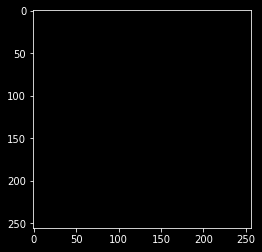

In [18]:
imgg = cv2.imread(dff["mask"][2])
plt.imshow(imgg)

In [19]:
from skimage import io

(256, 256, 3)
(256, 256)


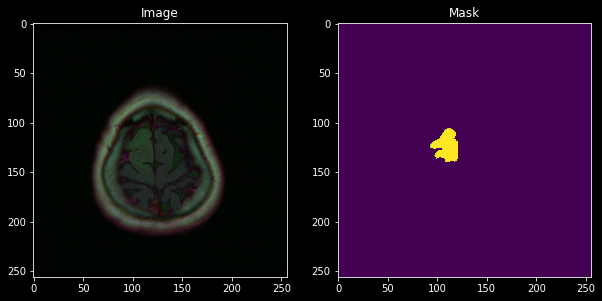

In [20]:
img_index = random.randint(0, len(dff["image"])-1)
img1 = cv2.imread(dff["image"][img_index])
img1_mask = cv2.imread(dff["mask"][img_index], 0)
fig = plt.figure(figsize=(10, 7))
fig.add_subplot(1,2,1)
plt.imshow(img1)
plt.title("Image")
fig.add_subplot(1,2,2)
plt.imshow(img1_mask)
plt.title("Mask")
print(img1.shape)
print(img1_mask.shape)

In [21]:
device = torch.device("cuda" if torch.cuda.is_available else "cpu")

In [22]:
train_df, test_df = train_test_split(dff, stratify=dff["diagnosis"], random_state=1, shuffle=True)

In [23]:
def data_augment():
    augmented_data = A.Compose([
                        A.Resize(width = 256, height = 256, p=1.0),
                        A.HorizontalFlip(p=0.5),
                        A.VerticalFlip(p=0.5),
                        A.RandomRotate90(p=0.5),
                        A.Transpose(p=0.5),
                        A.ShiftScaleRotate(shift_limit=0.01, scale_limit=0.04, rotate_limit=0, p=0.25),
                    
                        A.Normalize(),
                        ToTensorV2(),
    
])
    return augmented_data

In [36]:
dff.head()

,patient,image,mask,diagnosis
0,TCGA_CS_4941_19960909,Y:\Python\Datasets\Brain_Tumor\kaggle_3m\TCGA_...,Y:\Python\Datasets\Brain_Tumor\kaggle_3m\TCGA_...,0
1,TCGA_CS_4941_19960909,Y:\Python\Datasets\Brain_Tumor\kaggle_3m\TCGA_...,Y:\Python\Datasets\Brain_Tumor\kaggle_3m\TCGA_...,0
2,TCGA_CS_4941_19960909,Y:\Python\Datasets\Brain_Tumor\kaggle_3m\TCGA_...,Y:\Python\Datasets\Brain_Tumor\kaggle_3m\TCGA_...,0
3,TCGA_CS_4941_19960909,Y:\Python\Datasets\Brain_Tumor\kaggle_3m\TCGA_...,Y:\Python\Datasets\Brain_Tumor\kaggle_3m\TCGA_...,0
4,TCGA_CS_4941_19960909,Y:\Python\Datasets\Brain_Tumor\kaggle_3m\TCGA_...,Y:\Python\Datasets\Brain_Tumor\kaggle_3m\TCGA_...,0


In [25]:
class BrainDataset(Dataset):
    def __init__(self, df, transform=None):
        super().__init__()
        self.df = df
        self.transform = transform
        
    def __len__(self):
        return len(self.df)
    
    def __getitem__(self, index):
        image = cv2.imread(self.df.iloc[index, 1])
        mask = cv2.imread(self.df.iloc[index, 2])
        mask = cv2.cvtColor(mask, cv2.COLOR_BGR2GRAY)
        _, mask = cv2.threshold(mask, 127, 255, cv2.THRESH_BINARY)
        mask[mask>0.5] = 1.
        mask[mask<=0.5] = 0.
        augmented = self.transform(image=image, mask=mask)
        
        image = augmented["image"]
        mask = augmented["mask"].unsqueeze(0)
        
        return image.float(), mask.float()

In [37]:
df

,data_dir,img_path
0,TCGA_CS_4941_19960909,Y:\Python\Datasets\Brain_Tumor\kaggle_3m\TCGA_...
1,TCGA_CS_4941_19960909,Y:\Python\Datasets\Brain_Tumor\kaggle_3m\TCGA_...
2,TCGA_CS_4941_19960909,Y:\Python\Datasets\Brain_Tumor\kaggle_3m\TCGA_...
3,TCGA_CS_4941_19960909,Y:\Python\Datasets\Brain_Tumor\kaggle_3m\TCGA_...
4,TCGA_CS_4941_19960909,Y:\Python\Datasets\Brain_Tumor\kaggle_3m\TCGA_...
...,...,...
7853,TCGA_HT_A61B_19991127,Y:\Python\Datasets\Brain_Tumor\kaggle_3m\TCGA_...
7854,TCGA_HT_A61B_19991127,Y:\Python\Datasets\Brain_Tumor\kaggle_3m\TCGA_...
7855,TCGA_HT_A61B_19991127,Y:\Python\Datasets\Brain_Tumor\kaggle_3m\TCGA_...
7856,TCGA_HT_A61B_19991127,Y:\Python\Datasets\Brain_Tumor\kaggle_3m\TCGA_...


In [26]:
train_dataset = BrainDataset(train_df, data_augment())
train_loader = DataLoader(train_dataset, batch_size = 4, shuffle = True)

test_dataset = BrainDataset(test_df, data_augment())
test_loader = DataLoader(test_dataset, batch_size = 4)

In [27]:
for data, target in train_loader:
    print(data.shape)
    print(target.shape)
    print(torch.unique(target))
    break

torch.Size([4, 3, 256, 256])
torch.Size([4, 1, 256, 256])
tensor([0., 1.])


In [28]:
model = smp.Unet(encoder_name = "resnet34",
                encoder_weights = "imagenet",
                classes=1).to(device)

In [29]:
from segmentation_models_pytorch.encoders import get_preprocessing_fn

preprocess_input = get_preprocessing_fn('resnet18', pretrained='imagenet')

In [30]:
#IoU Metric
def dice_coef_metric(inputs, target):
    intersection = 2.0 * (target*inputs).sum()
    union = target.sum() + inputs.sum()
    if target.sum() == 0 and inputs.sum() == 0:
        return 1.0 
    return intersection/union

In [31]:
#Segmentation Loss
def dice_coef_loss(inputs, target):
    smooth = 1.0 
    intersection = 2.0 * (target*inputs).sum() + smooth
    union = target.sum() + inputs.sum() + smooth
    return 1 - (intersection/union)

def bce_dice_loss(inputs, target):
    dice_score = dice_coef_loss(inputs, target)
    bce_loss = nn.BCEWithLogitsLoss()
    bce_score = bce_loss(inputs, target)
    
    return bce_score + dice_score

In [32]:
def compute_iou(model, loader, threshold=0.3):
    valloss = 0
    
    with torch.no_grad():

        for i_step, (data, target) in enumerate(loader):
            
            data = data.to(device)
            target = target.to(device)
            
            outputs = model(data)

            out_cut = np.copy(outputs.data.cpu().detach())
            out_cut[np.nonzero(out_cut < threshold)] = 0.0
            out_cut[np.nonzero(out_cut >= threshold)] = 1.0

            picloss = dice_coef_metric(out_cut, target.data.cpu().numpy())
            valloss += picloss

    return valloss / i_step

In [33]:
folder = "Y:\\Python\\saved_imgs"

In [34]:
def save_preds_as_imgs(model, loader, folder = folder, device = "cuda"):
    
    model.eval()
    for batch, (x,y) in enumerate(tqdm(loader)):
        x = x.to(device=device)
        with torch.no_grad():
            preds = torch.sigmoid(model(x))
            preds = (preds>0.5).float()
        torchvision.utils.save_image(preds, f"{folder}//pred{batch}.png")
        torchvision.utils.save_image(y, f"{folder}")
    model.train()
                                     
            

  0%|          | 0/246 [00:00<?, ?it/s]

c:\users\admin\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  from ipykernel import kernelapp as app


KeyboardInterrupt: 

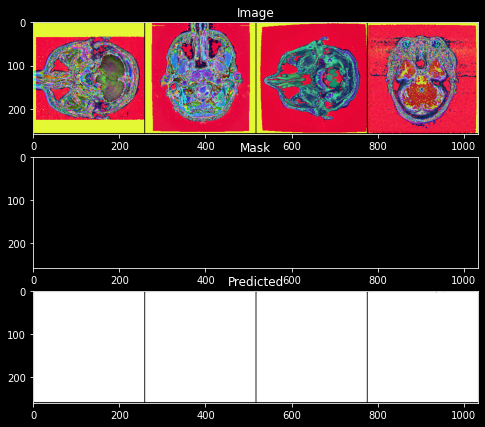

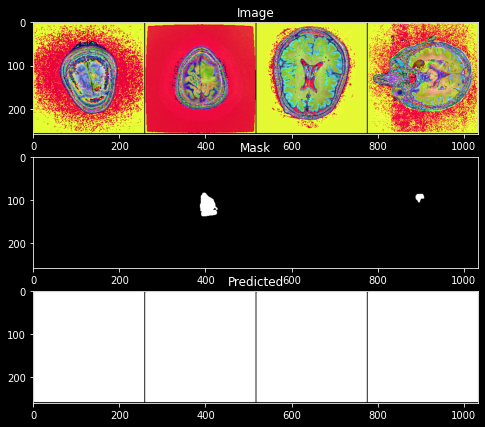

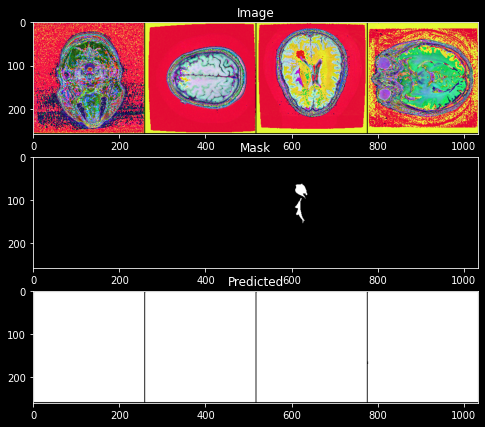

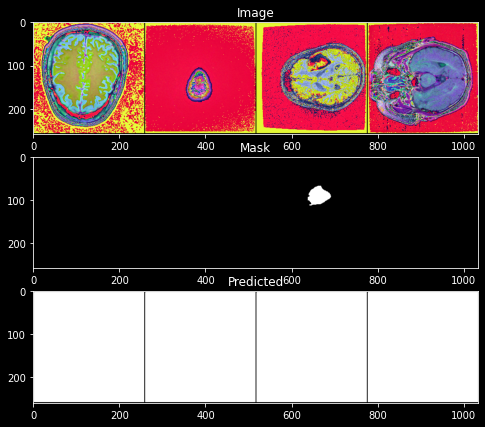

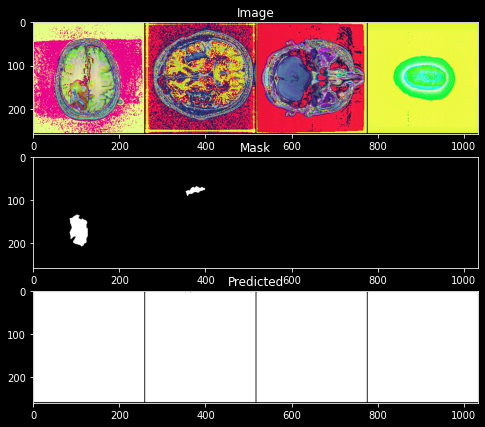

...

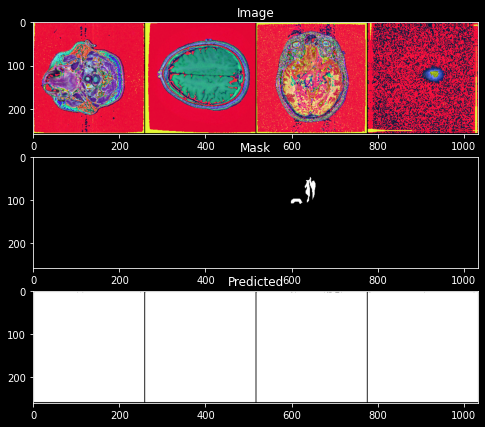

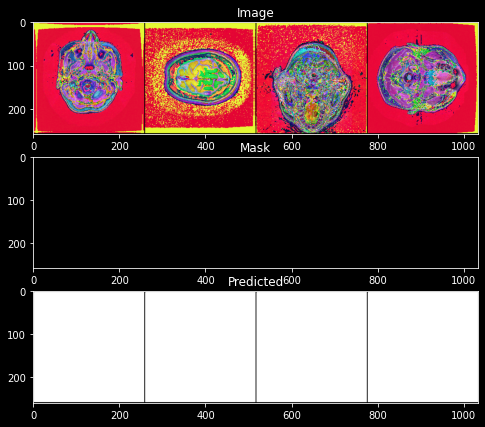

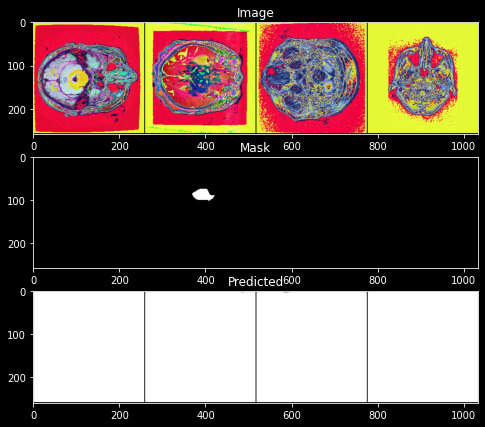

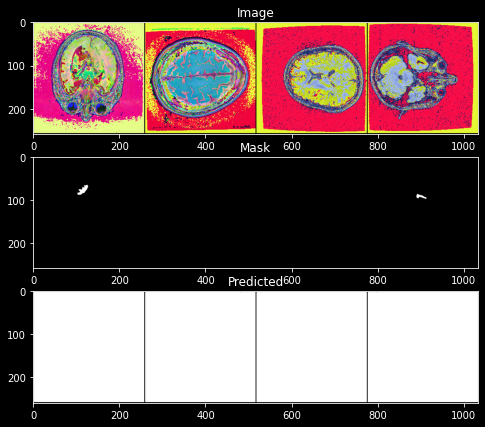

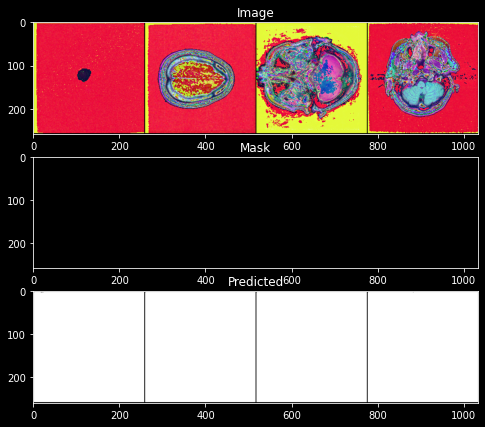

In [35]:
model.eval()
model.to(device)

for batch, (x,y) in enumerate(tqdm(test_loader)):
    x = x.to(device=device)
    with torch.no_grad():
        preds = torch.sigmoid(model(x))
        preds = (preds>0.5).float()
        

        x_to_img = T.ToPILImage()(make_grid(x))
        y_to_img = T.ToPILImage()(make_grid(y))
        preds_to_img = T.ToPILImage()(make_grid(preds))
        
        fig = plt.figure(figsize=(10, 7))
        fig.add_subplot(3,1,1)
        plt.imshow(x_to_img)
        plt.title("Image")
        
        fig.add_subplot(3,1,2)
        plt.imshow(y_to_img)
        plt.title("Mask")
        
        fig.add_subplot(3,1,3)
        plt.imshow(preds_to_img)
        plt.title("Predicted")
        
    
        

In [ ]:
plt.imshow(preds_to_img)

In [ ]:
model_folder = r"Y:\Python\Models"

In [ ]:
model.load_state_dict(torch.load(os.path.join(model_folder, "Brain_Model.pt")))

In [ ]:
train_loss = []
validation_loss = []

loss_history = []
train_history = []
val_history = []

NUM_EPOCHS = 50
optimizer = torch.optim.Adam(model.parameters())

for epoch in range(NUM_EPOCHS):
    model.train()
    model.to(device)
    losses = []
    train_iou = []
    
    for i_step, (data, target) in enumerate(tqdm(train_loader)):
        data = data.to(device)
        target = target.to(device)
        
        preds = model(data)
        out_cut = np.copy(preds.data.cpu().numpy())
        out_cut[np.nonzero(out_cut < 0.5)] = 0.0
        out_cut[np.nonzero(out_cut >= 0.5)] = 1.0
        
        train_dice = dice_coef_metric(out_cut, target.data.cpu().numpy())
        
        loss = bce_dice_loss(preds, target)
        
        losses.append(loss.item())
        train_iou.append(train_dice)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
    val_mean_iou = compute_iou(model, test_loader)
    
    loss_history.append(np.array(losses).mean())
    train_history.append(np.array(train_iou).mean())
    val_history.append(val_mean_iou)
    #if np.array(train_iou).mean() > 0.75:
    #    break
    
    print("Epoch [%d]" % (epoch))
    print("Mean loss on train:", np.array(losses).mean(), 
              "\nMean DICE on train:", np.array(train_iou).mean(), 
              "\nMean DICE on validation:", val_mean_iou)
    

In [ ]:
np.array(train_iou).mean()

In [ ]:
from torchvision.utils import save_image

In [ ]:
import torchvision
import torchvision.transforms as T
from PIL import Image

In [ ]:
#torch.save(model.state_dict(), os.path.join(model_folder, "Brain_Model.pt"))

In [ ]:
def compute_iou(model, loader, threshold=0.3):
    valloss = 0
    
    with torch.no_grad():

        for i_step, (data, target) in enumerate(loader):
            
            data = data.to(device)
            target = target.to(device)
            
            outputs = model(data)

            out_cut = np.copy(outputs.data.cpu().detach())
            out_cut[np.nonzero(out_cut < threshold)] = 0.0
            out_cut[np.nonzero(out_cut >= threshold)] = 1.0

            picloss = dice_coef_metric(out_cut, target.data.cpu().numpy())
            valloss += picloss

    return valloss / i_step

In [ ]:
def show_aug(inputs, nrows=5, ncols=5, norm=True):
    plt.figure(figsize=(10, 10))
    plt.subplots_adjust(wspace=0., hspace=0.)
    i_ = 0
    
    if len(inputs) > 25:
        inputs = inputs[:25]
        
    for idx in range(len(inputs)):
    
        # normalization
        if norm:           
            img = inputs[idx].numpy().transpose(1,2,0)
            mean = [0.485, 0.456, 0.406]
            std = [0.229, 0.224, 0.225] 
            img = (img*std+mean).astype(np.float32)
            
        else:
            img = inputs[idx].numpy().astype(np.float32)
            img = img[0,:,:]
        
        plt.subplot(nrows, ncols, i_+1)
        if len(img.shape) < 3:
            plt.imshow(img, cmap="gray")
        else:
            plt.imshow(img); 
        plt.axis('off')
        i_ += 1
        
    return plt.show()

In [ ]:
images, masks = next(iter(train_loader))
print(images.shape, masks.shape)

show_aug(images)
show_aug(masks, norm=False)

In [ ]:
for data, target in train_loader:
    print(data.shape)
    print(target.shape)
    break